# Tutorial 2b: Quantum Dynamics and Single-Qubit Gates
MIT 6.S089 Introduction to Quantum Computing - IAP 2024. Notebook developed by Shoumik Chowdhury and Bharath Kannan.

In [2]:
""" Import Relevant Packages """
import qutip as qt
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

""" Custom Helper Methods"""
from helpers import plot_bloch, animate_bloch

## 1. Intro to QuTiP: Quantum Toolbox in Python
We start by introducing the basics of the `qutip` package in Python. From the `qutip` [documentation](https://qutip.org/docs/latest/index.html): 

> _"QuTiP is a open-source Python package for calculations and numerical simulations of open quantum systems"_

The Python interface offers facilities for representing and doing calculations with quantum objects such as state vectors $|\psi\rangle$ and quantum operators $\hat{A}$, among others. 

QuTiP includes numerical solvers to simulate the time-evolution of quantum systems, e.g. by integration of the Schrödinger equation: $i\hbar \frac{d}{dt}|\psi(t)\rangle = \hat{H}|\psi(t)\rangle$. It also has more general solvers, e.g. for von-Neumann or master equations, as well as advanced solvers like Monte-Carlo quantum trajectories, etc. 

This tutorial is a first-pass at QuTiP to get you familiar with the basics of the package. We will use it to explore the time-dynamics of a simple single-qubit system, and demonstrate how to implement gates relevant to quantum computing. 

### Quantum object class: `Qobj`
The central structure of the QuTiP package is the `Qobj` class. This class is used to represent any quantum object, e.g. states $|\psi\rangle$ and operators $\hat{A}$. It is just a container for the vector or matrix representation, with some additional helper functions built in. 

In [26]:
ψ = qt.Qobj(np.array([1, 0])) # We define a quantum state that is represented by the vector (1, 0)
ψ

Quantum object: dims = [[2], [1]], shape = (2, 1), type = ket
Qobj data =
[[1.]
 [0.]]

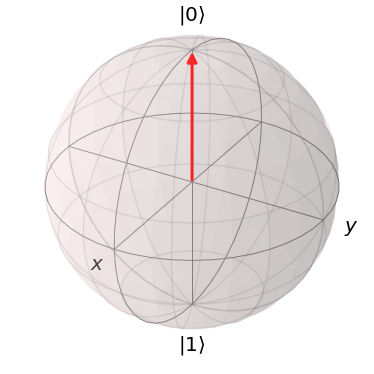

In [27]:
plot_bloch(ψ)

As stated before, the `Qobj()` contains the vector representation of a state, as well as some other information such as the dimensions and shape of the object (2x1 vector in this case), and whether the type of the object is a ket $|\psi\rangle$, a bra $\langle\psi|$, or an operator $\hat{O}$.

### Basis Vectors for a Qubit


The first task is to learn how to define a quantum state $|\psi\rangle$. We could just input vectors into the `Qobj()` constructor, as done above, but there are other functions that make this easier to do.

In our case, we would like to define quantum states that describe a two-level qubit, i.e. $|0\rangle$ and $|1\rangle$.

In [5]:
N = 2 # This defines how many levels we want our quantum states to have. In our case, this is 2.

Let's start by creating the state $|\psi\rangle = |0\rangle$. For this, we will need to use the `basis(N,i)` function in QuTiP:

In [6]:
ψ0 = qt.basis(N, 0)

The second arguement determines whether $|\psi\rangle$ is $|0\rangle$ or $|1\rangle$. In QuTiP's convention, $|0\rangle$ corresponds to the vector $(1, 0)^T$ and $|1\rangle$ to the vector $(0, 1)^T$. To check:

In [7]:
ψ0 # show the state

Quantum object: dims = [[2], [1]], shape = (2, 1), type = ket
Qobj data =
[[1.]
 [0.]]

$\textbf{Exercise:}$ Using the above example, define the variable $|1\rangle$ using the `basis()` function:

In [8]:
ψ1 = qt.basis(N, 1)
ψ1

Quantum object: dims = [[2], [1]], shape = (2, 1), type = ket
Qobj data =
[[0.]
 [1.]]

Sometimes, it easier to figure out what a state is by drawing it on the Bloch Sphere. I've created a handy helper function to do this for us:

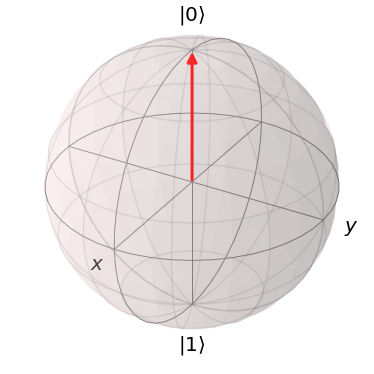

In [9]:
plot_bloch(ψ0)

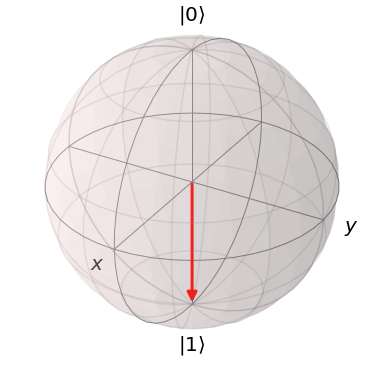

In [10]:
plot_bloch(ψ1)

### Other "cardinal" states of the Bloch sphere

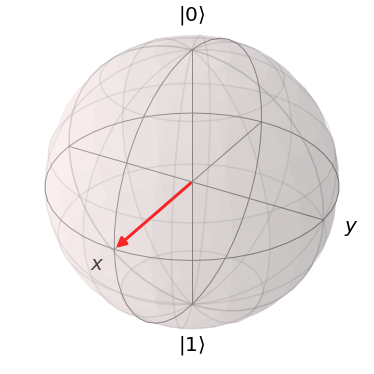

In [28]:
ψ_plus = (ψ0 + ψ1) / np.sqrt(2)
plot_bloch(ψ_plus)

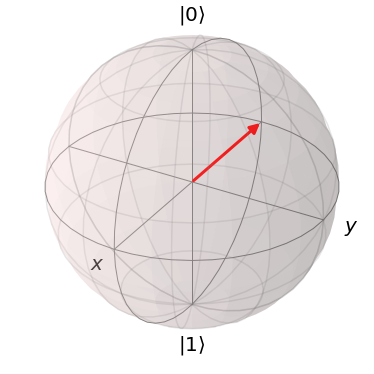

In [29]:
ψ_minus = (ψ0 - ψ1) / np.sqrt(2)
plot_bloch(ψ_minus)

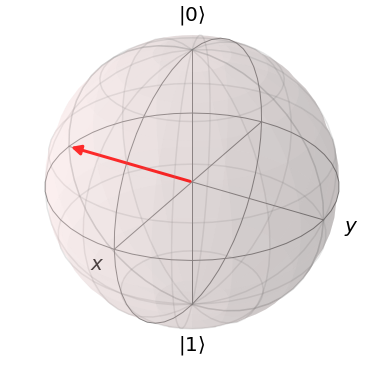

In [30]:
ψ_minus_i = (ψ0 - 1j*ψ1) / np.sqrt(2)
plot_bloch(ψ_minus_i)

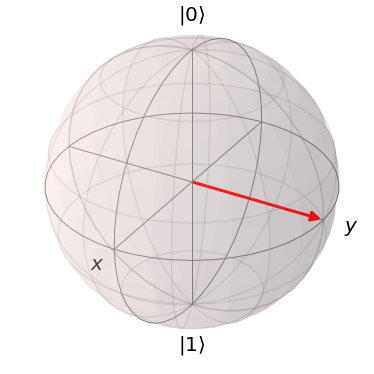

In [31]:
ψ_plus_i = (ψ0 + 1j*ψ1) / np.sqrt(2)
plot_bloch(ψ_plus_i)

### Arbitrary States

We can define the quantum state of a qubit to point anywhere along the Bloch sphere by defining two angles: $\theta$ and $\phi$. The state is defined as 

$$| \psi( \theta, \phi)\rangle = \cos\Big(\frac{\theta}{2}\Big) | 0 \rangle + e^{i \phi} \sin\Big(\frac{\theta}{2}\Big)|1\rangle$$






Here, $\theta \in [0,\pi]$ is the "azimuthal" angle from the z-axis and $\phi\in[0,2\pi]$ is the polar angle in the xy-plane (see [here](https://en.wikipedia.org/wiki/Bloch_sphere) for an example image).

$\textbf{Exercise:}$ Compete the function below that generates the state defined by $\theta$ and $\phi$

In [15]:
def psi(theta, phi):
    return np.cos(theta / 2) * ψ0 + np.exp(1j * phi) * np.sin(theta / 2) * ψ1

$\textbf{Exercise:}$ Find the $\theta$ and $\phi$ that point the state vector along the 6 poles of the Bloch sphere ($\pm z, \pm x, \pm y$). Plot the results on the Bloch Sphere for each case.

$+z$:

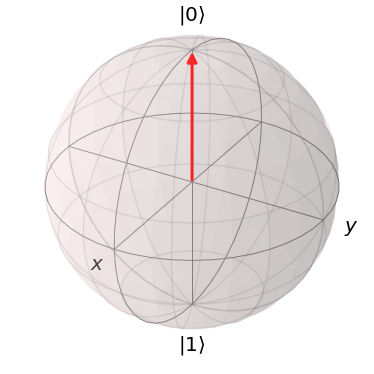

In [16]:
(θ, φ) = (0, 0)

plot_bloch(psi(θ, φ))

$-z$:

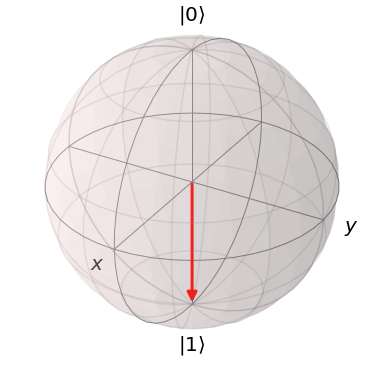

In [17]:
(θ, φ) = (np.pi, 0)

plot_bloch(psi(θ, φ))

$+x$:

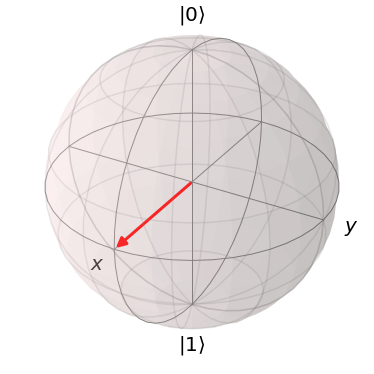

In [18]:
(θ, φ) = (np.pi/2, 0)

plot_bloch(psi(θ, φ))

$-x$:

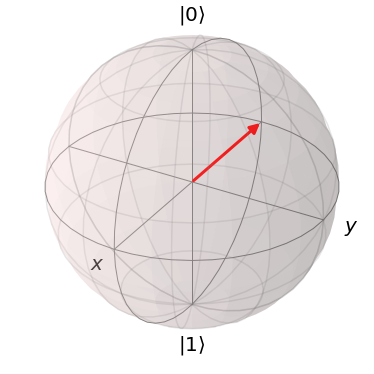

In [19]:
(θ, φ) = (-np.pi/2, 0)

plot_bloch(psi(θ, φ))

$+y$:

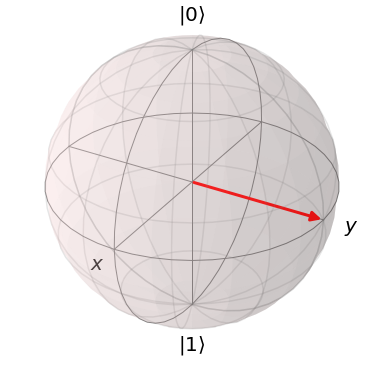

In [20]:
(θ, φ) = (np.pi/2, np.pi/2)

plot_bloch(psi(θ, φ))

$-y$:

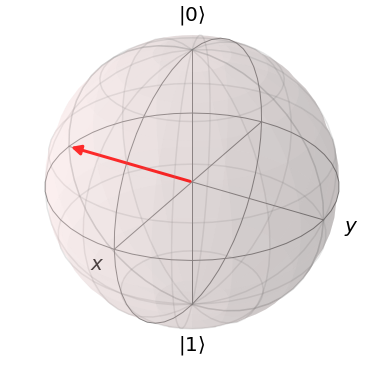

In [21]:
(θ, φ) = (np.pi/2, -np.pi/2)

plot_bloch(psi(θ, φ))

### Quantum Operators (Matrices)

Now that we have learned how to represent arbitrary states on the Bloch Sphere, we can now learn how quantum operators, represented as matrices, are defined in QuTiP.

Operators in QuTiP are also instances of the same `Qobj()` class used to define states $|\psi\rangle$. However, the dimensions of the data in the QobJ will now be an $N \times N$ square matrix. For example, we could create the identity operator as follows:

In [32]:
I = qt.Qobj([[1,0],[0,1]])
I

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[1. 0.]
 [0. 1.]]

Defining operators on an element-wise basis can get a bit annoying and repetitive. Luckily for us, QuTiP has many built-in functions to generate the most commonly used operators. For example, we can use the qeye() function to generate the same identity operator:

In [33]:
I = qt.qeye(N) #qeye() takes in an argument defining the dimension of the identity operator. In our case, we want N = 2.
I

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[1. 0.]
 [0. 1.]]

When trying to perform calculations of a TLS, the pauli operators $\hat{\sigma}_x, \hat{\sigma}_y$, and $\hat{\sigma}_z$ are very useful (as we discussed during the lecture). QuTiP has built-in functions for these too: 

$\hat{\sigma}_x$

In [34]:
qt.sigmax()

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[0. 1.]
 [1. 0.]]

$\hat{\sigma}_y$

In [35]:
qt.sigmay()

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[0.+0.j 0.-1.j]
 [0.+1.j 0.+0.j]]

$\hat{\sigma}_z$

In [36]:
qt.sigmaz()

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[ 1.  0.]
 [ 0. -1.]]

With these operators in hand, we can now try to perform some simulations of how quantum states evolve.

## Quantum State Evolution

Recall from lecture the Schrödinger equation that determined how a quantum state $|\psi(t)\rangle$ evolves given a Hamitonian operator $\hat{H}$:

$$i\hbar\frac{d}{dt}|\psi(t)\rangle = \hat{H}|\psi(t)\rangle$$

While this equation may look intimidating at first, we should remember that this equation is simply a set of first-order differential equations that are written in a rather compact notation. However, for this course, we do not really need to think too deeply about it: the solution to this equation (assuming the Hamiltonian is time-independent) is simply given by 

$$|\psi(t)\rangle = e^{-i \hat{H} t} |\psi(t = 0)\rangle$$


where $|\psi(t = 0)\rangle$ is the initial state of the qubit at $t = 0$.

Furthermore, QuTiP makes our lives easy and provides us with a function that automatically solves the Schrödinger equation given a Hamiltonian $\hat{H}$, the initial state of the system $|\psi(t = 0)\rangle$, and a list of times $t$ to simulate. Let's try out a simple example. This function is called `sesolve()` 

### Example 1: $\hat{H} = I$
Consider the case where the Hamiltonian is simply the Identity $\hat{H} = I$. In this case, we would expect the system to always remain in the initial state, since the Identity operation should do nothing. Let's check this.

In [ ]:
H = qt.qeye(2)
psi_init = ψ0  # let's pick the psi_up state as the initial state
tlist = np.linspace(0,np.pi, 51) # We need to define a list of times that the Schrödinger equation is solved

result = qt.sesolve(H, psi_init, tlist) # we provide the sesolve() function with the three pieces of information stated above

In [ ]:
plot_bloch(result.states[-1])

### Example 2: $\hat{H} = \Omega\,\hat{\sigma}_x$

Let's now try a more interesting Hamiltonian. Specifically let's look at $\hat{H}=\hat{\sigma}_x$ and $|\psi(t=0)\rangle = |0\rangle$, as discussed in the tutorial slides.

In [37]:
""" Set up the Hamiltonian """
Ω = 5
H = Ω * qt.sigmax()
H

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[0. 5.]
 [5. 0.]]

In [41]:
psi_init = ψ0 # [1, 0]
tlist = np.linspace(0, 1, 101)

""" Solve Schrödinger equation """
result = qt.sesolve(H, psi_init, tlist)

In [42]:
animate_bloch(result)

### Example 3: $\hat{H} = \Omega\,\hat{\sigma}_y$

Let's now try a more interesting Hamiltonian. Specifically let's look at $\hat{H}=\Omega\hat{\sigma}_y$ and $|\psi(t=0)\rangle = |0\rangle$, as discussed in the tutorial slides.

In [43]:
""" Set up the Hamiltonian """
Ω = 2
H = Ω * qt.sigmay()
psi_init = ψ0 # [1, 0]
tlist = np.linspace(0, np.pi / (2*Ω), 41)

""" Solve Schrödinger equation """
result = qt.sesolve(H, psi_init, tlist)

In [ ]:
plot_bloch(result.states[-1])

In [ ]:
result.states[-1]

In [44]:
animate_bloch(result)

### Example 3: $\hat{H} = \Omega\,\hat{\sigma}_z$

In [ ]:
""" Set up the Hamiltonian """
Ω = 5
H = Ω * qt.sigmaz()
psi_init = ψ0 # [1, 0]
tlist = np.linspace(0, 1, 61)

""" Solve Schrödinger equation """
result = qt.sesolve(H, psi_init, tlist)

In [ ]:
animate_bloch(result)

### Arbitrary Control Hamiltonian

Great! After all that, it seems that depedning on which Pauli operator we choose, we rotate the initial state vector about that axis by an angle $2t$. But this brings up another question: can we only rotate state vectors about the x, y, or z axes? Or is there a way to generalize this such that the vector can rotate about any arbitrary axis? 

Much like how we came up with a way to represent states that can point in any arbitrary direction on the Bloch sphere, we can come up with a Hamiltonian that rotates these states about an arbitrary axis. It turns out that this Hamiltonian also parameterized by the same two angle $\theta$ and $\phi$:

$$\hat{H}(\theta,\phi) = \sin(\theta)\cos(\phi)\hat{\sigma}_x + \sin(\theta)\sin(\phi)\hat{\sigma}_y + \cos(\theta)\hat{\sigma}_z$$

This Hamiltonian will rotate any initial state about the axis that points in the direction of the state vector $|\psi(\theta,\phi)\rangle$. 

In [ ]:
def Hamiltonian(theta,phi):
    return np.sin(theta)*np.cos(phi)*qt.sigmax() + np.sin(theta)*np.sin(phi)*qt.sigmay()+np.cos(theta)*qt.sigmaz()

$\textbf{Exercise:}$ Find the values of $\theta$ and $\phi$ such that $\hat{H}(\theta,\phi) = \hat{\sigma}_x$, $\hat{H}(\theta,\phi) = \hat{\sigma}_y$, and $\hat{H}(\theta,\phi) = \hat{\sigma}_z$. Once you find those values, plot the state $|\psi(\theta,\phi)\rangle$ on the Bloch sphere. What do you notice?

## Simulation Qubit Decay and Loss: Master Equations

### Bare Decay

In [ ]:
ψ1

In [ ]:
qt.destroy(2)

In [ ]:
""" Set up the Hamiltonian """
H = 0 * qt.qeye(N) # set to zero Hamiltonian
psi_init = ψ1
tlist = np.linspace(0, 10, 4001)

T1 = 2; γ = 1 / T1
L = np.sqrt(γ) * qt.destroy(2) # σ- operator

""" Solve Master equation """
result = qt.mesolve(H, psi_init, tlist, c_ops=[L], e_ops=[qt.sigmaz()], options=qt.Options(store_states=True))

In [ ]:
# Animate and display in Jupyter notebook

snapshot_every_n = 50
animate_bloch(result.states[::snapshot_every_n])

In [ ]:
# Get raw animation to save as mp4

anim_to_save = animate_bloch(result.states[::snapshot_every_n], return_animation=True)
anim_to_save.save('animation.gif', writer='imagemagick', fps=10)

In [ ]:
expect_σz = result.expect[0]
Pr_1 = (1 - expect_σz) / 2

In [ ]:
# Plot the data
fig, ax = plt.subplots(dpi=200)
ax.plot(tlist[::snapshot_every_n], Pr_1[::snapshot_every_n], 'o', label = "Data")


# Curve fit to fit the data to an exponential decay
def exp_func(ts, γ):
    """
    Fit function for exponential decay y(t) = exp(-γt)
    """
    return np.exp(-γ * ts)
popt, _ = curve_fit(exp_func, tlist, Pr_1)


ax.plot(tlist, exp_func(tlist, *popt), label = fr"Exponential Fit: $T_1$ = {1/popt[0]:.2f}", linewidth=2)
ax.set_xlabel("Time")
ax.set_ylabel(r"Excited State Probability: Pr$(1\rangle)$")
plt.legend()